In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import imputation3 as imp

In [2]:
pathTrainData = '../html2023-spring-final-project-stage-2/html2023-spring-final-project/train.csv'
pathTestData = '../html2023-spring-final-project-stage-2/html2023-spring-final-project/test.csv'
helpTestDance = '../html2023-spring-final-project-stage-2/test_partial_answer.csv'

In [3]:
train = pd.read_csv(pathTrainData)
test = pd.read_csv(pathTestData)
partialAnswer = pd.read_csv(helpTestDance)

In [4]:
train.head(2)

,Danceability,Energy,Key,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,...,Album,Uri,Url_spotify,Url_youtube,Comments,Description,Title,Channel,Composer,Artist
0,0.0,0.000273,3.0,-25.176,0.0443,0.724151,0.000062,0.000807,0.340,83.398,...,Sinkovsky Plays and Sings Vivaldi,spotify:track:7njAZhca4o80qQdCgyEWya,https://open.spotify.com/artist/2QOIawHpSlOwXD...,https://www.youtube.com/watch?v=NzCL9uLkQSI,3070.0,Antonio Vivaldi's 4th Concerto - From his Most...,"Antonio Vivaldi - Concerto No.4 in F minor, Op...",Mozafunkula,NaN,Marshmello
1,0.0,0.184220,7.0,NaN,NaN,0.672221,0.910000,0.034966,0.746,148.692,...,NaN,spotify:track:2nnXe7n3Vivs7OfQKRsfWD,https://open.spotify.com/artist/2QOIawHpSlOwXD...,https://www.youtube.com/watch?v=jAnzlpPuIDU,122.0,"A. Vivaldi Concerto No. 2 in G minor, RV 315, ...","A. Vivaldi Concerto No. 2 in G minor, RV 315, ...",Anton Paisov,Finneas O'Connell,Bon Iver


In [5]:
def is_nan(x):
    if type(x) == float:
        if np.isnan(x):
            return True
        else:
            return False

def LabelEncoding(data):
    k = data.unique()
    nlabel = {}
    for i, label in enumerate(k):
        if not is_nan(label):
            nlabel[label] = i#f'{i}'
    return nlabel

def categoricalData(data, list):
    labels = {}
    for i in list:
        if i != 'Key':
            labels[i] = LabelEncoding(data[i])
    return labels

def getDatasetReady(data):
    categoryList = ['Key', 'Album_type', 'Url_spotify', 'Channel', 'Composer']
    # data.loc[data['id'].isin(partialAnswer['id']), 'Danceability'] = partialAnswer['Danceability']
    data.set_index('id', inplace= True)
    data.drop(columns=['Uri', 'Url_youtube', 'Description', 'Title', 'Artist', 'Album', 'Track', "official_video", "Licensed"], inplace=True)



    labels = categoricalData(data, categoryList)

    for i in categoryList:
        if i != 'Key':
            data[i] = data[i].replace(labels[i])
    return data


In [6]:
trainProcess = getDatasetReady(train)

In [7]:
trainImputCopy = trainProcess.copy()
trainY = trainImputCopy['Danceability']
trainImputCopy = trainImputCopy.drop(columns=['Danceability'], axis=1)

INIT IMPUTER

In [8]:
trainImputCopy=trainImputCopy.loc[:, ['Energy', 'Loudness', 'Speechiness',
       'Acousticness', 'Instrumentalness', 'Liveness', 'Valence', 'Tempo', 'Views', 'Likes', 'Stream', 'Comments', 'Duration_ms', 'Key', 'Album_type', 'Url_spotify', 'Channel', 'Composer']]

In [9]:
impute = imp.testImputate(trainImputCopy)

In [10]:
impute.loadPredictions()
trainInputed  = impute.miceTrainedModel(trainImputCopy, savePredictions=True)

___ Processing Energy ___
___ Processing Loudness ___
___ Processing Speechiness ___
___ Processing Acousticness ___
___ Processing Instrumentalness ___
___ Processing Liveness ___
___ Processing Valence ___
___ Processing Tempo ___
___ Processing Views ___
___ Processing Likes ___
___ Processing Stream ___
___ Processing Comments ___
___ Processing Duration_ms ___
___ Processing Key ___
___ Processing Album_type ___
___ Processing Url_spotify ___
___ Processing Channel ___
___ Processing Composer ___
-- Imputation Done --


In [11]:
trainInputed.head(3)

,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Views,Likes,Stream,Comments,Duration_ms,Key,Album_type,Url_spotify,Channel,Composer
id,,,,,,,,,,,,,,,,,,
0,0.000273,-25.176000,0.044300,0.724151,0.000062,0.000807,0.340,83.398,1.921244e+07,137622.0,1.998137e+07,3070.0,117907.0,3.0,0.0,0.0,0.0,1.0
1,0.184220,-10.662656,0.112644,0.672221,0.910000,0.034966,0.746,148.692,1.848250e+05,5190.0,4.281608e+07,122.0,173427.0,7.0,0.0,0.0,1.0,1.0
2,0.046035,-15.596000,0.068766,0.667628,0.867000,0.001772,0.380,84.899,1.848250e+05,5190.0,1.932081e+07,122.0,150667.0,6.0,0.0,0.0,1.0,1.0


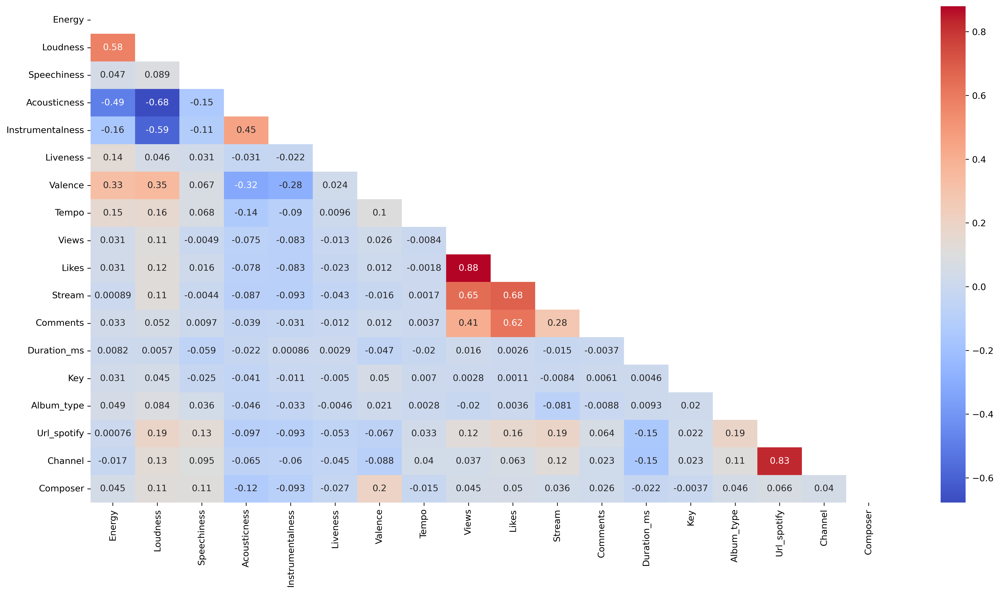

In [12]:
fig, ax = plt.subplots(figsize=(20, 10), dpi=300)
mask = np.triu(np.ones_like(trainInputed.corr()))
dataplot = sns.heatmap(trainInputed.corr(), cmap="coolwarm", annot=True, mask=mask)

GET NEW DATA FOR IMPUTED DATASET

In [13]:
def processTrainingData(data):
    from sklearn.preprocessing import MinMaxScaler
    # from sklearn.preprocessing import OneHotEncoder

    dataCopy = data.copy()

    cat = ['Key','Album_type','Url_spotify','Channel','Composer']
    for i in cat:
        dataCopy[i]=dataCopy[i].astype(int)


    # trainedCat = dataCopy.iloc[:,dataCopy.columns.isin(['Key', 'Composer', "Album_type"])]
    standardize = dataCopy.iloc[:, dataCopy.columns.isin(['Loudness', 'Duration_ms', 'Views', 'Likes', 'Stream',  'Comments'])]
    normaldata = dataCopy.iloc[:, ~dataCopy.columns.isin(['Loudness', 'Duration_ms', 'Views', 'Likes', 'Stream', 'Comments' ])]

    # Scale Data
    scaler = MinMaxScaler()
    scaledData = scaler.fit_transform(standardize)
    scaledDataPD = pd.DataFrame(scaledData, columns=standardize.columns)
    scaledDataPD.set_index(normaldata.index, inplace=True)  

    # OneHotEncoder
    # onehotEncoder =  OneHotEncoder()
    # encoded = onehotEncoder.fit_transform( trainedCat)
    # onehotEncodedData = pd.DataFrame(data=encoded.toarray(), columns=onehotEncoder.get_feature_names_out())
    # onehotEncodedData.set_index(normaldata.index, inplace=True)

    trainData = pd.concat((normaldata, scaledDataPD), axis=1)

    return scaler,  trainData

def processTrainingDataTest(data, scaler):

    dataCopy = data.copy()

    cat = ['Key','Album_type','Url_spotify','Channel','Composer']
    for i in cat:
        dataCopy[i]=dataCopy[i].astype(int)
    # trainedCat = dataCopy.iloc[:,dataCopy.columns.isin(['Key', 'Composer', "Album_type"])]
    standardize = dataCopy.iloc[:, dataCopy.columns.isin(['Loudness', 'Duration_ms', 'Views', 'Likes', 'Stream',  'Comments'])]
    normaldata = dataCopy.iloc[:, ~dataCopy.columns.isin(['Loudness', 'Duration_ms', 'Views', 'Likes', 'Stream', 'Comments' ])]


    # Scale Data
    scaler = scaler
    scaledData = scaler.transform(standardize)
    scaledDataPD = pd.DataFrame(scaledData, columns=standardize.columns)
    scaledDataPD = scaledDataPD.set_index(normaldata.index)
    scaledDataPD.set_index(normaldata.index, inplace=True)    

    # OneHotEncoder
    # onehotEncoder =  onehotEncoder
    # encoded = onehotEncoder.transform( trainedCat)
    # onehotEncodedData = pd.DataFrame(data=encoded.toarray(), columns=onehotEncoder.get_feature_names_out())
    # onehotEncodedData.set_index(normaldata.index, inplace=True)

    testData = pd.concat((normaldata, scaledDataPD), axis=1)

    return testData

PREPROCESSING 

In [14]:
scaler, trainDataReady = processTrainingData(trainInputed)

In [15]:
trainDataReady.head(3)

,Energy,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Key,Album_type,Url_spotify,Channel,Composer,Loudness,Views,Likes,Stream,Comments,Duration_ms
id,,,,,,,,,,,,,,,,,,
0,0.000273,0.044300,0.724151,0.000062,0.000807,0.340,83.398,3,0,0,0,1,0.447642,0.003328,0.003428,0.005898,0.000191,0.024976
1,0.184220,0.112644,0.672221,0.910000,0.034966,0.746,148.692,7,0,0,1,1,0.755912,0.000032,0.000129,0.012641,0.000008,0.037104
2,0.046035,0.068766,0.667628,0.867000,0.001772,0.380,84.899,6,0,0,1,1,0.651126,0.000032,0.000129,0.005703,0.000008,0.032132


SHUFFLE DATA

In [16]:
# from sklearn.utils import shuffle
# X_train, y_train = shuffle(trainDataReady, trainY)

GET READY TEST DATA

In [17]:
testProcess = getDatasetReady(test)

In [18]:
testProcess=testProcess.loc[:, ['Energy', 'Loudness', 'Speechiness',
       'Acousticness', 'Instrumentalness', 'Liveness', 'Valence', 'Tempo', 'Views', 'Likes', 'Stream', 'Comments', 'Duration_ms', 'Key', 'Album_type', 'Url_spotify', 'Channel', 'Composer']]

In [19]:
testInputed  = impute.miceTrainedModel(testProcess, savePredictions=True)

___ Processing Energy ___
___ Processing Loudness ___
___ Processing Speechiness ___
___ Processing Acousticness ___
___ Processing Instrumentalness ___
___ Processing Liveness ___
___ Processing Valence ___
___ Processing Tempo ___
___ Processing Views ___
___ Processing Likes ___
___ Processing Stream ___
___ Processing Comments ___
___ Processing Duration_ms ___
___ Processing Key ___
___ Processing Album_type ___
___ Processing Url_spotify ___
___ Processing Channel ___
___ Processing Composer ___
-- Imputation Done --


In [20]:
partialAnswer=  partialAnswer.set_index('id')

In [21]:
partialAnswer.index

Int64Index([18871, 18872, 18873, 18879, 18882, 18886, 18887, 18894, 18896,
            18899,
            ...
            23405, 23421, 23434, 23436, 23442, 23462, 23463, 23473, 23482,
            23484],
           dtype='int64', name='id', length=631)

In [22]:
testInputedData = testInputed.copy()


In [23]:
testInputedData = testInputedData.loc[partialAnswer.index, :]

In [24]:
testInputedData

,Energy,Loudness,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Views,Likes,Stream,Comments,Duration_ms,Key,Album_type,Url_spotify,Channel,Composer
id,,,,,,,,,,,,,,,,,,
18871,0.611960,-4.873391,0.071052,0.004574,0.000193,0.000634,0.635413,121.002000,1.488170e+08,937061.000000,1.112196e+08,24156.000000,255773.000000,10.0,0.0,590.609438,562.0,2.0
18872,0.410132,-6.356726,0.091200,0.016777,0.001590,0.029038,0.962000,121.002000,1.488170e+08,940001.238702,1.499055e+08,24156.000000,241541.639076,3.0,0.0,183.000000,562.0,2.0
18873,0.148036,-10.117000,0.280000,0.000007,0.079383,0.066923,0.512154,99.439000,4.140185e+06,54975.265002,4.495917e+07,1597.000000,217097.658709,6.0,0.0,183.000000,566.0,2.0
18879,0.167284,-7.504550,0.101000,0.043987,0.000000,0.003049,0.391000,118.114252,8.687921e+07,703605.000000,1.986931e+07,14291.000000,302602.000000,10.0,2.0,932.900397,569.0,3.0
18882,0.098611,-7.576000,0.040300,0.440711,0.000000,0.000625,0.450000,125.900000,3.363790e+05,9175.000000,9.368100e+05,379.000000,77480.000000,10.0,0.0,184.000000,570.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23462,0.307725,-2.533880,0.033415,0.156774,0.013672,0.001309,0.770259,95.871722,2.393215e+06,48870.132301,4.514250e+07,6036.000000,123963.758812,7.0,0.0,973.000000,187.0,1.0
23463,0.269900,-11.299350,0.104984,0.006946,0.001588,0.001355,0.466107,103.858359,1.175475e+08,380658.971091,6.228127e+07,940.000000,193565.214910,0.0,2.0,24.000000,2629.0,2.0
23473,0.480568,-3.828332,0.075315,0.153384,0.001714,0.000114,0.287141,91.755727,7.459512e+06,829.008568,3.013345e+06,202.000000,193892.112089,8.0,0.0,634.000000,2633.0,1.0


In [25]:
testInputedDataReady = processTrainingDataTest(testInputedData, scaler)

In [26]:
testInputedDataReady.head(3)

,Energy,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Key,Album_type,Url_spotify,Channel,Composer,Loudness,Views,Likes,Stream,Comments,Duration_ms
id,,,,,,,,,,,,,,,,,,
18871,0.611960,0.071052,0.004574,0.000193,0.000634,0.635413,121.002,10,0,590,562,2,0.878879,0.025775,0.023340,0.032840,0.001502,0.055091
18872,0.410132,0.091200,0.016777,0.001590,0.029038,0.962000,121.002,3,0,183,562,2,0.847372,0.025775,0.023414,0.044263,0.001502,0.051983
18873,0.148036,0.280000,0.000007,0.079383,0.066923,0.512154,99.439,6,0,183,566,2,0.767502,0.000717,0.001369,0.013274,0.000099,0.046643


In [27]:
from sklearn.model_selection import train_test_split
X_train, X_Validation, y_train, y_Validation = train_test_split(testInputedDataReady, partialAnswer, test_size=0.2, random_state=42)

In [28]:

X_test = trainDataReady
y_test = trainY


# X_Validation = X_test
# y_Validation = y_test

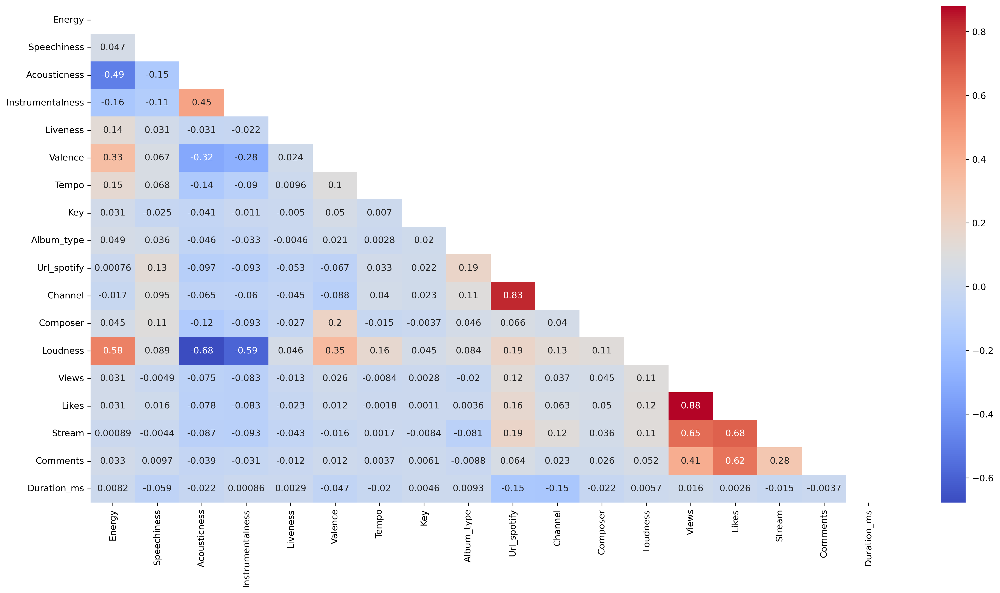

In [29]:
fig, ax = plt.subplots(figsize=(20, 10), dpi=300)
mask = np.triu(np.ones_like(X_test.corr()))
dataplot = sns.heatmap(X_test.corr(), cmap="coolwarm", annot=True, mask=mask)

In [30]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

def printErrors(y, y_hat):
    acc = accuracy_score(y, y_hat)
    mae = mean_absolute_error(y, y_hat)
    mse = mean_squared_error(y, y_hat)

    print(f'ACC: {acc * 100}, MAE:{mae}, MSE:{mse}')
    # return acc * 100, mae, mse

In [31]:
totaltest = testInputed.copy()

totaltest_X = processTrainingDataTest(totaltest, scaler)

In [32]:
totaltest_X.head(3)

,Energy,Speechiness,Acousticness,Instrumentalness,Liveness,Valence,Tempo,Key,Album_type,Url_spotify,Channel,Composer,Loudness,Views,Likes,Stream,Comments,Duration_ms
id,,,,,,,,,,,,,,,,,,
17170,0.350403,0.1770,5.842771e-07,0.002330,0.230346,0.53541,138.559,6,0,0,0,0,0.840527,0.120121,0.154951,0.307168,0.010564,0.047854
17171,0.347429,0.0302,3.225859e-02,0.000687,0.000099,0.85200,92.761,8,0,0,0,1,0.858879,0.012472,0.020182,0.091562,0.001928,0.042946
17172,0.786330,0.0522,7.676563e-05,0.020704,0.001561,0.55100,108.014,1,2,0,0,1,0.898917,0.001461,0.007028,0.018620,0.000460,0.046218


In [33]:
categorical_features = ['Key', 'Album_type', 'Url_spotify', 'Channel', 'Composer']

In [34]:
predictTest = pd.DataFrame()
predictionResults = pd.DataFrame()

In [40]:
import lightgbm as lgb
from itertools import product
from tqdm import tqdm
import warnings

warnings.filterwarnings("ignore")

# Create a logger and set verbosity level
# logger =  lgb.getLogger()
# logger.setLevel(lgb.logging.WARNING)

categories = len(y_test.unique())

# learning_rate = [0.001, 0.03, 0.3]
# max_depth = [4, 5, 10]
# num_leaves = [50, 100, 200]
# bagging_fraction = [0.4, 0.6, 0.8]
# bagging_freq = [2, 5, 10]
# objective = ['multiclass', 'multiclassova']
# boosting_type = ['gbdt', 'rf', 'dart', 'goss']
# tree_learner = ['feature', 'data', 'voting']

lr = [0.001]
max_depth = [4, 5, 10]
num_leaves = [50, 100, 200]
bagging_fraction = [0.4, 0.6, 0.8]
bagging_freq = [2, 5, 10]
objective = ['multiclass', 'multiclassova']
boosting_type = ['gbdt', 'rf']
tree_learner = ['feature', 'data', 'voting']


filter = list(product(lr, max_depth, num_leaves, bagging_fraction, bagging_freq, objective, boosting_type, tree_learner))

categorical_features = ['Key', 'Album_type', 'Url_spotify', 'Channel', 'Composer']

# pbar = tqdm(total=len(filter))

lgb_train = lgb.Dataset(X_train, y_train, categorical_feature= categorical_features, free_raw_data=False)
lgb_eval = lgb.Dataset(X_Validation, y_Validation, reference=lgb_train)

byAcc = -float('inf')
paramByAcc = {}
byMAE = float('inf')
paramByMAE = {}
best_iterationAcc = 0
best_iterationMAE = 0

for learning_rate, max_depth, num_leaves, bagging_fraction, bagging_freq,  objective, boosting_type,  tree_learner  in filter:
    
    if boosting_type == 'goss':
        lightParams1 = {
        'objective': objective,
        'num_class': categories ,  # Specify the number of classes
        'metric': 'multi_error',
        'boosting_type': boosting_type,
        "max_depth": max_depth,
        "num_leaves": num_leaves,
        # "bagging_fraction": bagging_fraction,
        # "bagging_freq": bagging_freq,
        'learning_rate':learning_rate,
        'tree_learner':tree_learner,
        # 'max_bin': 255,
        # 'device': 'gpu',
        "verbosity": -1
        }
    else:

        lightParams1 = {
        'objective': objective,
        'num_class': categories ,  # Specify the number of classes
        'metric': 'multi_error',
        'boosting_type': boosting_type,
        "max_depth": max_depth,
        "num_leaves": num_leaves,
        "bagging_fraction": bagging_fraction,
        "bagging_freq": bagging_freq,
        'learning_rate':learning_rate,
        'tree_learner':tree_learner,
        # 'max_bin': 255,
        # 'device': 'gpu',
        
        "verbosity": -1
    }

    gbm = lgb.train(lightParams1, lgb_train, num_boost_round=2000, valid_sets=lgb_eval, early_stopping_rounds=10,  verbose_eval=False)# callbacks=[lgb.early_stopping(stopping_rounds=5)])

    pred = gbm.predict(X_test, num_iteration=gbm.best_iteration+1)
    y_pred = pred.argmax(axis=1)

    acc = accuracy_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)

    if acc > byAcc:
        byAcc = acc
        paramByAcc = lightParams1
        best_iterationAcc = gbm.best_iteration

    if mae < byMAE:
        byMAE = mae
        paramByMAE = lightParams1
        best_iterationMAE = gbm.best_iteration
    





print("RESULTS")
print("By ACC")
print(f'acc: {byAcc}')
print(f'best_iterationAcc: {best_iterationAcc}')
print(f'Parameters: {paramByAcc}')
print("----------------------------------------------------------------")
print("By MAE")
print(f'acc: {byMAE}')
print(f'best_iterationAcc: {best_iterationMAE}')
print(f'Parameters: {paramByMAE}')



    

RESULTS
By ACC
acc: 0.1588235294117647
best_iterationAcc: 41
Parameters: {'objective': 'multiclass', 'num_class': 10, 'metric': 'multi_error', 'boosting_type': 'rf', 'max_depth': 10, 'num_leaves': 50, 'bagging_fraction': 0.4, 'bagging_freq': 2, 'learning_rate': 0.001, 'tree_learner': 'feature', 'verbosity': -1}
----------------------------------------------------------------
By MAE
acc: 2.509668025626092
best_iterationAcc: 7
Parameters: {'objective': 'multiclass', 'num_class': 10, 'metric': 'multi_error', 'boosting_type': 'gbdt', 'max_depth': 4, 'num_leaves': 50, 'bagging_fraction': 0.4, 'bagging_freq': 2, 'learning_rate': 0.001, 'tree_learner': 'feature', 'verbosity': -1}


In [38]:
y_test.unique()

array([0., 1., 4., 6., 5., 3., 2., 9., 8., 7.])

In [44]:
categories = len(y_test.unique())
Parameters= {'objective': 'multiclass', 'num_class': 10, 'metric': 'multi_error', 'boosting_type': 'rf', 'max_depth': 10, 'num_leaves': 50, 'bagging_fraction': 0.4, 'bagging_freq': 2, 'learning_rate': 0.001, 'tree_learner': 'feature', 'verbosity': -1}
import lightgbm as lgb


# create dataset for lightgbm
lgb_train = lgb.Dataset(X_train, y_train, categorical_feature= categorical_features)
lgb_eval = lgb.Dataset(X_Validation, y_Validation, reference=lgb_train)
gbm = lgb.train(Parameters,
                lgb_train,
                num_boost_round=41,
                valid_sets=lgb_eval, verbose_eval=False)

pred = gbm.predict(X_test)
y_pred = pred.argmax(axis=1)
printErrors(y_test, y_pred)
print(gbm.best_iteration)


predTotal = gbm.predict(totaltest_X)
y_predTotal = predTotal.argmax(axis=1)

predictTest['lightGBM1'] = y_pred
predictionResults['lightGBM1'] = y_predTotal

ACC: 15.88235294117647, MAE:2.772976121141526, MSE:12.860920209668025
0


In [51]:
from catboost import CatBoostClassifier , Pool
# Specify the column indices of categorical features
cat_feature_indices = [7, 8, 9, 10, 11]

train_data = Pool(data=X_train,label=y_train, cat_features=cat_feature_indices)
eval_data = Pool(data=X_Validation,label=y_Validation, cat_features=cat_feature_indices)
test_data =Pool(data=X_test,label=y_test, cat_features=cat_feature_indices)

parameters = {'depth': 4, 'l2_leaf_reg': 1, 'learning_rate': 0.1, 'bootstrap_type': 'Bayesian','iterations':1500}
model = CatBoostClassifier(**parameters)

model.fit(train_data,  verbose=True)

predictions = model.predict(test_data)

printErrors(y_test, predictions)

y_predTotal = model.predict(totaltest_X)

predictTest['CatBoostClassifier1'] = predictions.flatten()
predictionResults['CatBoostClassifier1'] = y_predTotal.flatten()

0:	learn: 2.2749471	total: 29.7ms	remaining: 44.5s
1:	learn: 2.2519018	total: 68.2ms	remaining: 51s
2:	learn: 2.2296461	total: 108ms	remaining: 54s
3:	learn: 2.2070871	total: 142ms	remaining: 53.2s
4:	learn: 2.1894105	total: 192ms	remaining: 57.3s
5:	learn: 2.1729233	total: 238ms	remaining: 59.3s
6:	learn: 2.1626418	total: 278ms	remaining: 59.3s
7:	learn: 2.1465439	total: 331ms	remaining: 1m 1s
8:	learn: 2.1344324	total: 359ms	remaining: 59.5s
9:	learn: 2.1198163	total: 399ms	remaining: 59.4s
10:	learn: 2.1129935	total: 439ms	remaining: 59.5s
11:	learn: 2.0934906	total: 507ms	remaining: 1m 2s
12:	learn: 2.0840766	total: 557ms	remaining: 1m 3s
13:	learn: 2.0748376	total: 593ms	remaining: 1m 2s
14:	learn: 2.0684408	total: 661ms	remaining: 1m 5s
15:	learn: 2.0566022	total: 704ms	remaining: 1m 5s
16:	learn: 2.0448406	total: 754ms	remaining: 1m 5s
17:	learn: 2.0303375	total: 810ms	remaining: 1m 6s
18:	learn: 2.0236212	total: 861ms	remaining: 1m 7s
19:	learn: 2.0149236	total: 908ms	remaining

In [52]:
from sklearn.ensemble import RandomForestClassifier
randomForestClass = RandomForestClassifier(n_estimators=1000, random_state=456)
randomForestClass.fit(X_train, y_train)

predVal = randomForestClass.predict(X_Validation)
printErrors(y_Validation, predVal)

predTest = randomForestClass.predict(X_test)
printErrors(y_test, predTest)

predTestTotal = randomForestClass.predict(totaltest_X)

predictTest['rfc1'] = predTest
predictionResults['rfc1'] = predTestTotal

ACC: 25.984251968503933, MAE:2.220472440944882, MSE:9.354330708661417
ACC: 15.602795573675015, MAE:2.76371578334304, MSE:12.670180547466511


In [54]:
categories = len(y_test.unique())
# For XGBRegressor parameters
xboost_param = {
    'objective': 'multi:softmax',
    'booster': 'gbtree',
    'eval_metric': "merror",
    'num_class': categories,
    'learning_rate': 0.03,#2.3e-4,
    'max_depth': 4,
    'min_child_weight': 10,
    'lambda':1e-3,
    'alpha':1e-6,
    'verbosity': 0
}

import xgboost as xgb


dtrain = xgb.DMatrix(data=X_train, label=y_train)
dValidation = xgb.DMatrix(data=X_Validation, label=y_Validation)
xboostModel = xgb.train(xboost_param, dtrain, num_boost_round=92,  evals=[(dtrain, 'train'), (dValidation, 'validation')])


print('best ', xboostModel.best_iteration+1)
dtest = xgb.DMatrix(X_test)
y_pred = xboostModel.predict(dtest, ntree_limit=xboostModel.best_iteration+1)


printErrors(y_test, y_pred)

dtestTotal = xgb.DMatrix(totaltest_X)
xboostPred = xboostModel.predict(dtestTotal, ntree_limit=xboostModel.best_iteration+1)

predictTest['XBoost'] = y_pred
predictionResults['XBoost'] = xboostPred

[0]	train-merror:0.68849	validation-merror:0.75591
[1]	train-merror:0.68651	validation-merror:0.75591
[2]	train-merror:0.65873	validation-merror:0.76378
[3]	train-merror:0.66071	validation-merror:0.77165
[4]	train-merror:0.65278	validation-merror:0.76378
[5]	train-merror:0.64881	validation-merror:0.77953
[6]	train-merror:0.64881	validation-merror:0.79528
[7]	train-merror:0.64881	validation-merror:0.79528
[8]	train-merror:0.63492	validation-merror:0.80315
[9]	train-merror:0.63690	validation-merror:0.81890
[10]	train-merror:0.61905	validation-merror:0.81890
[11]	train-merror:0.61111	validation-merror:0.81890
[12]	train-merror:0.61310	validation-merror:0.81890
[13]	train-merror:0.59127	validation-merror:0.81890
[14]	train-merror:0.60317	validation-merror:0.81102
[15]	train-merror:0.58532	validation-merror:0.80315
[16]	train-merror:0.57540	validation-merror:0.78740
[17]	train-merror:0.57341	validation-merror:0.81102
[18]	train-merror:0.57540	validation-merror:0.79528
[19]	train-merror:0.56

In [55]:
copyPredictTest = predictTest.copy()
ErrorsPD = pd.DataFrame()

ErrorsPD['Mean'] = copyPredictTest.mean(axis=1)
ErrorsPD['Median'] = copyPredictTest.median(axis=1)
ErrorsPD['Max'] = copyPredictTest.max(axis=1)

prevtest = copyPredictTest.round()
ErrorsPD['Voted'] = prevtest.mode(axis=1).iloc[:, 0]

copyPredictTest = copyPredictTest.set_index(y_test.index)
ErrorsPD = ErrorsPD.set_index(y_test.index)



print("-----MEDIAN-----")
printErrors(y_test, ErrorsPD['Median'].round())
print("-----MEAN-----")
printErrors(y_test, ErrorsPD['Mean'].round())
print("-----MAX-----")
printErrors(y_test, ErrorsPD['Max'].round())

print("-----VOTED-----")
printErrors(y_test, ErrorsPD['Voted'].round())

ErrorsPD['Y']=y_test

-----MEDIAN-----
ACC: 16.83750728013978, MAE:2.4019219569015724, MSE:9.833721607454864
-----MEAN-----
ACC: 15.99883517763541, MAE:2.2300524170064064, MSE:8.298078043098428
-----MAX-----
ACC: 13.424577751892835, MAE:3.1548631333721606, MSE:15.838147932440302
-----VOTED-----
ACC: 16.930693069306933, MAE:2.630693069306931, MSE:11.752533488642982


In [56]:
joined = pd.concat((copyPredictTest, ErrorsPD) , axis=1)

In [57]:
joined.to_csv('./resultsTest/testModelByTESTINGDATA.csv')

In [58]:
copypredictionResults = predictionResults.copy()
ErrorsPDTotal = pd.DataFrame()

ErrorsPDTotal['Mean'] = copypredictionResults.mean(axis=1)
ErrorsPDTotal['Median'] = copypredictionResults.median(axis=1)
ErrorsPDTotal['Max'] = copypredictionResults.max(axis=1)
prevtest = copypredictionResults.round()
ErrorsPDTotal['Voted'] = prevtest.mode(axis=1).iloc[:, 0]
# copyPredictTest['Median'] = copyPredictTest.median(axis=1).astype(int)
copypredictionResults = copypredictionResults.set_index(totaltest_X.index)
ErrorsPDTotal = ErrorsPDTotal.set_index(totaltest_X.index)

In [59]:
joinedTotal = pd.concat((copypredictionResults, ErrorsPDTotal) , axis=1)

In [60]:
joinedTotal.to_csv('./resultsTest/testTotalModelByTESTINGDATA.csv')

In [51]:
categories = len(y_test['Danceability'].unique())
lightParams1 = {
    'objective': 'multiclassova',
    'num_class': categories ,  # Specify the number of classes
    'metric': 'multi_error',
    'boosting_type': 'random_forest',
    "max_depth": 10,
    "num_leaves": 100,
    "bagging_fraction": 0.8,
    "bagging_freq": 2,
    'learning_rate':1e-4,
    "verbosity":2
}

import lightgbm as lgb


# create dataset for lightgbm
lgb_train = lgb.Dataset(X_train, y_train, categorical_feature= categorical_features)
lgb_eval = lgb.Dataset(X_Validation, y_Validation, reference=lgb_train)
gbm = lgb.train(lightParams1,
                lgb_train,
                num_boost_round=1000,
                valid_sets=lgb_eval,
                callbacks=[lgb.early_stopping(stopping_rounds=50)])

pred = gbm.predict(X_test, num_iteration=gbm.best_iteration+1)
y_pred = pred.argmax(axis=1)
printErrors(y_test, y_pred)

predTotal = gbm.predict(totaltest_X, num_iteration=gbm.best_iteration+1)
y_predTotal = predTotal.argmax(axis=1)

predictTest['lightGBM1'] = y_pred
predictionResults['lightGBM1'] = y_predTotal

c:\Users\Miguel\anaconda3\lib\site-packages\lightgbm\basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
c:\Users\Miguel\anaconda3\lib\site-packages\lightgbm\basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['Album_type', 'Channel', 'Composer', 'Key', 'Url_spotify']
  _log_warning('categorical_feature in Dataset is overridden.\n'
c:\Users\Miguel\anaconda3\lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
c:\Users\Miguel\anaconda3\lib\site-packages\lightgbm\basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Info] Number of positive: 1310, number of negative: 12426
[LightGBM] [Info] Number of positive: 1268, number of negative: 12468
[LightGBM] [Info] Number of positive: 1327, number of negative: 12409
[LightGBM] [Info] Number of positive: 1366, number of negative: 12370
[LightGBM] [Info] Number of positive: 1329, number of negative: 12407
[LightGBM] [Info] Number of positive: 1352, number of negative: 12384
[LightGBM] [Info] Number of positive: 1481, number of negative: 12255
[LightGBM] [Info] Number of positive: 1446, number of negative: 12290
[LightGBM] [Info] Number of positive: 1514, number of negative: 12222
[LightGBM] [Info] Number of positive: 1343, number of negative: 12393
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.089918
[LightGBM] [Debug] init for col-wise cost 0.000006 seconds, init for row-wise cost 0.000733 seconds
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001371 seconds.
You can set `for

In [36]:
X_train.columns

Index(['Energy', 'Speechiness', 'Acousticness', 'Instrumentalness', 'Liveness',
       'Valence', 'Tempo', 'Key', 'Album_type', 'Url_spotify', 'Channel',
       'Composer', 'Loudness', 'Views', 'Likes', 'Stream', 'Comments',
       'Duration_ms'],
      dtype='object')

In [41]:
from catboost import CatBoostClassifier , Pool
# Specify the column indices of categorical features
cat_feature_indices = [7, 8, 9, 10, 11]

train_data = Pool(data=X_train,label=y_train, cat_features=cat_feature_indices)
eval_data = Pool(data=X_Validation,label=y_Validation, cat_features=cat_feature_indices)
test_data =Pool(data=X_test,label=y_test, cat_features=cat_feature_indices)



model = CatBoostClassifier(iterations=552,bootstrap_type='Bernoulli', learning_rate=0.03, depth=10, l2_leaf_reg= 3)
model.fit(train_data, eval_set=eval_data,  verbose=True)
predictions = model.predict(test_data)

printErrors(y_test, predictions)

y_predTotal = model.predict(totaltest_X)

predictTest['CatBoostClassifier'] = predictions
predictionResults['CatBoostClassifier'] = y_predTotal

0:	learn: 2.2911758	test: 2.2916347	best: 2.2916347 (0)	total: 1.09s	remaining: 10m
1:	learn: 2.2786414	test: 2.2799890	best: 2.2799890 (1)	total: 2.24s	remaining: 10m 16s
2:	learn: 2.2648129	test: 2.2677725	best: 2.2677725 (2)	total: 3.43s	remaining: 10m 28s
3:	learn: 2.2526208	test: 2.2561636	best: 2.2561636 (3)	total: 4.37s	remaining: 9m 58s
4:	learn: 2.2419620	test: 2.2474006	best: 2.2474006 (4)	total: 5.41s	remaining: 9m 52s
5:	learn: 2.2313672	test: 2.2382968	best: 2.2382968 (5)	total: 6.69s	remaining: 10m 8s
6:	learn: 2.2245529	test: 2.2301927	best: 2.2301927 (6)	total: 6.8s	remaining: 8m 49s
7:	learn: 2.2161092	test: 2.2224563	best: 2.2224563 (7)	total: 7.93s	remaining: 8m 59s
8:	learn: 2.2076389	test: 2.2147566	best: 2.2147566 (8)	total: 9.33s	remaining: 9m 23s
9:	learn: 2.2032538	test: 2.2098105	best: 2.2098105 (9)	total: 9.4s	remaining: 8m 29s
10:	learn: 2.1943070	test: 2.2022681	best: 2.2022681 (10)	total: 10.6s	remaining: 8m 43s
11:	learn: 2.1853361	test: 2.1950988	best: 2

In [45]:
from catboost import CatBoostClassifier , Pool
cat_feature_indices = [7, 8, 9, 10, 11]

train_data = Pool(data=X_train,label=y_train, cat_features=cat_feature_indices)
eval_data = Pool(data=X_Validation,label=y_Validation, cat_features=cat_feature_indices)
test_data =Pool(data=X_test,label=y_test, cat_features=cat_feature_indices)


model = CatBoostClassifier(loss_function='MultiClass',  task_type="GPU",devices='0:1')
grid = {'bootstrap_type':['Bayesian', 'Bernoulli', 'Poisson'],
    'learning_rate': [0.001, 0.01, 0.03, 0.1],
        'depth': [4, 6, 10, 50],
        'l2_leaf_reg': [1, 3, 5, 7, 9]}

grid_search_result = model.grid_search(grid,
                                       X=X_train,
                                       y=y_train,
                                       plot=True)

grid_search_result.values()

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 2.3020978	test: 2.3025192	best: 2.3025192 (0)	total: 13.1ms	remaining: 13.1s
1:	learn: 2.3016144	test: 2.3025262	best: 2.3025192 (0)	total: 19.3ms	remaining: 9.61s
2:	learn: 2.3011581	test: 2.3024182	best: 2.3024182 (2)	total: 37.5ms	remaining: 12.5s
3:	learn: 2.3006745	test: 2.3022603	best: 2.3022603 (3)	total: 42.2ms	remaining: 10.5s
4:	learn: 2.3003031	test: 2.3022002	best: 2.3022002 (4)	total: 68.4ms	remaining: 13.6s
5:	learn: 2.2998363	test: 2.3021131	best: 2.3021131 (5)	total: 74ms	remaining: 12.3s
6:	learn: 2.2994354	test: 2.3021195	best: 2.3021131 (5)	total: 100ms	remaining: 14.2s
7:	learn: 2.2989719	test: 2.3019701	best: 2.3019701 (7)	total: 107ms	remaining: 13.3s
8:	learn: 2.2985334	test: 2.3018823	best: 2.3018823 (8)	total: 112ms	remaining: 12.4s
9:	learn: 2.2980810	test: 2.3018062	best: 2.3018062 (9)	total: 117ms	remaining: 11.6s
10:	learn: 2.2976153	test: 2.3017460	best: 2.3017460 (10)	total: 122ms	remaining: 11s
11:	learn: 2.2972258	test: 2.3015993	best: 2.30159

dict_values([{'depth': 4, 'l2_leaf_reg': 1, 'learning_rate': 0.1, 'bootstrap_type': 'Bayesian'}, defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193,

In [59]:
from catboost import CatBoostClassifier , Pool
# Specify the column indices of categorical features
cat_feature_indices = [7, 8, 9, 10, 11]

train_data = Pool(data=X_train,label=y_train, cat_features=cat_feature_indices)
eval_data = Pool(data=X_Validation,label=y_Validation, cat_features=cat_feature_indices)
test_data =Pool(data=X_test,label=y_test, cat_features=cat_feature_indices)



model = CatBoostClassifier(iterations=716,bootstrap_type='Bayesian', learning_rate=0.03, depth=6, l2_leaf_reg= 1)

model.fit(train_data, eval_set=eval_data,  verbose=True)

predictions = model.predict(test_data)

printErrors(y_test, predictions)

y_predTotal = model.predict(totaltest_X)

predictTest['CatBoostClassifier1'] = predictions
predictionResults['CatBoostClassifier1'] = y_predTotal

0:	learn: 2.2899126	test: 2.2896871	best: 2.2896871 (0)	total: 212ms	remaining: 2m 31s
1:	learn: 2.2780837	test: 2.2780194	best: 2.2780194 (1)	total: 424ms	remaining: 2m 31s
2:	learn: 2.2679861	test: 2.2675218	best: 2.2675218 (2)	total: 640ms	remaining: 2m 32s
3:	learn: 2.2562696	test: 2.2555010	best: 2.2555010 (3)	total: 839ms	remaining: 2m 29s
4:	learn: 2.2458088	test: 2.2452426	best: 2.2452426 (4)	total: 1.05s	remaining: 2m 29s
5:	learn: 2.2360430	test: 2.2354315	best: 2.2354315 (5)	total: 1.22s	remaining: 2m 24s
6:	learn: 2.2258649	test: 2.2252720	best: 2.2252720 (6)	total: 1.4s	remaining: 2m 22s
7:	learn: 2.2172686	test: 2.2164259	best: 2.2164259 (7)	total: 1.58s	remaining: 2m 19s
8:	learn: 2.2090578	test: 2.2080910	best: 2.2080910 (8)	total: 1.76s	remaining: 2m 18s
9:	learn: 2.2000134	test: 2.1990502	best: 2.1990502 (9)	total: 1.91s	remaining: 2m 15s
10:	learn: 2.1919491	test: 2.1910934	best: 2.1910934 (10)	total: 2.08s	remaining: 2m 13s
11:	learn: 2.1838823	test: 2.1826391	best:

In [364]:
from sklearn.ensemble import RandomForestClassifier
randomForestClass = RandomForestClassifier(n_estimators=1000, random_state=456)
randomForestClass.fit(X_train, y_train)

predVal = randomForestClass.predict(X_Validation)
printErrors(y_Validation, predVal)

predTest = randomForestClass.predict(X_test)
printErrors(y_test, predTest)

predTestTotal = randomForestClass.predict(totaltest_X)

predictTest['rfc1'] = predTest
predictionResults['rfc1'] = predTestTotal

ACC: 16.957210776545168, MAE:3.160063391442155, MSE:16.114104595879557
ACC: 16.957210776545168, MAE:3.160063391442155, MSE:16.114104595879557


In [301]:
# from sklearn.ensemble import RandomForestClassifier
# randomForestClass = RandomForestClassifier(n_estimators=2000, random_state=276)
# randomForestClass.fit(X_train, y_train)

# predVal = randomForestClass.predict(X_Validation)
# printErrors(y_Validation, predVal)

# predTest = randomForestClass.predict(X_test)
# printErrors(y_test, predTest)

# predTestTotal = randomForestClass.predict(totaltest_X)

# predictTest['rfc2'] = predTest
# predictionResults['rfc2'] = predTestTotal

ACC: 16.164817749603806, MAE:3.1489698890649764, MSE:15.80824088748019
ACC: 16.164817749603806, MAE:3.1489698890649764, MSE:15.80824088748019


In [302]:
# from sklearn.ensemble import RandomForestRegressor

# randomForestregressor = RandomForestRegressor(n_estimators=100, random_state=123)
# randomForestregressor.fit(X_train, y_train)

# predVal = randomForestregressor.predict(X_Validation)
# predValInt = predVal.round()
# printErrors(y_Validation, predValInt)

# predTest = randomForestregressor.predict(X_test)
# predTestInt = predTest.round()
# printErrors(y_test, predTestInt)

# y_predTotal = randomForestregressor.predict(totaltest_X)


# predictTest['rfr1'] = predTest
# predictionResults['rfr1'] = y_predTotal

In [365]:
categories = len(y_test['Danceability'].unique())
# For XGBRegressor parameters
xboost_param = {
    'objective': 'multi:softmax',
    'booster': 'gbtree',
    'eval_metric': "merror",
    'num_class': categories,
    'learning_rate': 1e-3,#2.3e-4,
    'max_depth': 25,
    'min_child_weight': 10,
    'lambda':1e-3,
    'alpha':1e-2,
    'verbosity': 0
}

import xgboost as xgb


dtrain = xgb.DMatrix(data=X_train, label=y_train)
dValidation = xgb.DMatrix(data=X_Validation, label=y_Validation)
xboostModel = xgb.train(xboost_param, dtrain, num_boost_round=92,  evals=[(dtrain, 'train'), (dValidation, 'validation')])


print('best ', xboostModel.best_iteration+1)
dtest = xgb.DMatrix(X_test)
y_pred = xboostModel.predict(dtest, ntree_limit=xboostModel.best_iteration+1)


printErrors(y_test, y_pred)

dtestTotal = xgb.DMatrix(totaltest_X)
xboostPred = xboostModel.predict(dtestTotal, ntree_limit=xboostModel.best_iteration+1)

predictTest['XBoost'] = y_pred
predictionResults['XBoost'] = xboostPred

[0]	train-merror:0.64292	validation-merror:0.84152
[1]	train-merror:0.64024	validation-merror:0.84628
[2]	train-merror:0.63931	validation-merror:0.84311
[3]	train-merror:0.63832	validation-merror:0.84469
[4]	train-merror:0.63524	validation-merror:0.84786
[5]	train-merror:0.63442	validation-merror:0.84469
[6]	train-merror:0.63436	validation-merror:0.84469
[7]	train-merror:0.63372	validation-merror:0.84786
[8]	train-merror:0.63361	validation-merror:0.84786
[9]	train-merror:0.63296	validation-merror:0.84786
[10]	train-merror:0.63267	validation-merror:0.84628
[11]	train-merror:0.63203	validation-merror:0.84945
[12]	train-merror:0.63087	validation-merror:0.84945
[13]	train-merror:0.63162	validation-merror:0.84945
[14]	train-merror:0.63063	validation-merror:0.85103
[15]	train-merror:0.63087	validation-merror:0.85103
[16]	train-merror:0.62994	validation-merror:0.84786
[17]	train-merror:0.62976	validation-merror:0.84786
[18]	train-merror:0.62964	validation-merror:0.84628
[19]	train-merror:0.63

c:\Users\Miguel\anaconda3\lib\site-packages\xgboost\core.py:122: UserWarning: ntree_limit is deprecated, use `iteration_range` or model slicing instead.
  warnings.warn(
c:\Users\Miguel\anaconda3\lib\site-packages\xgboost\core.py:122: UserWarning: ntree_limit is deprecated, use `iteration_range` or model slicing instead.
  warnings.warn(


In [304]:
# default_params = {
#     'objective': 'reg:squarederror',
#     'booster': 'gbtree',
#     'eval_metric': "rmse",
#     'learning_rate': 1e-3,#2.3e-4,
#     'max_depth': 25,
#     'min_child_weight': 10,
#     'lambda':1e-3,
#     'alpha':1e-2,
#     'verbosity': 0
# }

# import xgboost as xgb


# dtrain = xgb.DMatrix(data=X_train, label=y_train)
# dValidation = xgb.DMatrix(data=X_Validation, label=y_Validation)
# xboostModel = xgb.train(default_params, dtrain, num_boost_round=1538, evals=[(dtrain, 'train'), (dValidation, 'validation')])

# dtest = xgb.DMatrix(X_test)
# y_pred = xboostModel.predict(dtest,  ntree_limit=xboostModel.best_iteration+1)
# yPred = y_pred.round()
# # y_pred = y_pred.argmax(axis=1)

# printErrors(y_test, yPred)

# dtestTotal = xgb.DMatrix(totaltest_X)
# xboostPred = xboostModel.predict(dtestTotal, ntree_limit=xboostModel.best_iteration+1)
# # xboostPred = xboostPred.argmax(axis=1)

# predictTest['XBoost1'] = y_pred
# predictionResults['XBoost1'] = xboostPred

In [366]:
categories = len(y_test['Danceability'].unique())
lightParams1 = {
    'objective': 'multiclassova',
    'num_class': categories ,  # Specify the number of classes
    'metric': 'multi_error',
    'boosting_type': 'random_forest',
    "max_depth": 6,
    "num_leaves": 50,
    "bagging_fraction": 0.8,
    "bagging_freq": 2,
    "verbosity":2
}

import lightgbm as lgb


# create dataset for lightgbm
lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_Validation, y_Validation, reference=lgb_train)
gbm = lgb.train(lightParams1,
                lgb_train,
                num_boost_round=200,
                valid_sets=lgb_eval,
                callbacks=[lgb.early_stopping(stopping_rounds=1000)])

pred = gbm.predict(X_test, num_iteration=gbm.best_iteration+1)
y_pred = pred.argmax(axis=1)
printErrors(y_test, y_pred)

predTotal = gbm.predict(totaltest_X, num_iteration=gbm.best_iteration+1)
y_predTotal = predTotal.argmax(axis=1)

predictTest['lightGBM1'] = y_pred
predictionResults['lightGBM1'] = y_predTotal

[LightGBM] [Info] Number of positive: 1655, number of negative: 15515
[LightGBM] [Info] Number of positive: 1639, number of negative: 15531
[LightGBM] [Info] Number of positive: 1664, number of negative: 15506
[LightGBM] [Info] Number of positive: 1675, number of negative: 15495
[LightGBM] [Info] Number of positive: 1639, number of negative: 15531
[LightGBM] [Info] Number of positive: 1702, number of negative: 15468
[LightGBM] [Info] Number of positive: 1856, number of negative: 15314
[LightGBM] [Info] Number of positive: 1826, number of negative: 15344
[LightGBM] [Info] Number of positive: 1860, number of negative: 15310
[LightGBM] [Info] Number of positive: 1654, number of negative: 15516
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.039313
[LightGBM] [Debug] init for col-wise cost 0.000015 seconds, init for row-wise cost 0.000889 seconds
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002145 seconds.
You can set `for

In [306]:
# params = {
#     'objective': 'multiclass',
#     'num_class': categories ,  # Specify the number of classes
#     'metric': 'multi_error',
#     'boosting_type': 'gbdt',
#     "max_depth": 50,
#     "num_leaves": 5,
#     "bagging_fraction": 0.6,
#     "bagging_freq": 2,
#     "learning_rate":1e-2,
#     "feature_fraction":0.5,
#     'lambda_l1':1e-3,
#     "lambda_l2":1e-2,
#     'min_data_in_leaf':10,
#     "verbosity":1
# }

# import lightgbm as lgb


# # create dataset for lightgbm
# lgb_train = lgb.Dataset(X_train, y_train)
# lgb_eval = lgb.Dataset(X_Validation, y_Validation, reference=lgb_train)
# gbm = lgb.train(params,
#                 lgb_train,
#                 num_boost_round=500,
#                 valid_sets=lgb_eval,
#                 callbacks=[lgb.early_stopping(stopping_rounds=50)])

# pred = gbm.predict(X_test, num_iteration=gbm.best_iteration+1)
# y_pred = pred.argmax(axis=1)
# printErrors(y_test, y_pred)

# predTotal = gbm.predict(totaltest_X, num_iteration=gbm.best_iteration+1)
# y_predTotal = predTotal.argmax(axis=1)

# predictTest['lightGBM2'] = y_pred
# predictionResults['lightGBM2'] = y_predTotal

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001198 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2319
[LightGBM] [Info] Number of data points in the train set: 17170, number of used features: 21
[LightGBM] [Info] Start training from score -2.339363
[LightGBM] [Info] Start training from score -2.349077
[LightGBM] [Info] Start training from score -2.333939
[LightGBM] [Info] Start training from score -2.327351
[LightGBM] [Info] Start training from score -2.349077
[LightGBM] [Info] Start training from score -2.311360
[LightGBM] [Info] Start training from score -2.224740
[LightGBM] [Info] Start training from score -2.241036
[LightGBM] [Info] Start training from score -2.222587
[LightGBM] [Info] Start training from score -2.339967
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[144]	valid_0's multi_error: 0.85103
ACC: 14.896988906497624, MAE:3.2852

In [307]:
# params = {
#     'objective': 'regression',
#     'metric': 'rmse',
#     'boosting_type': 'gbdt',
#     "max_depth": 100,
#     "num_leaves": 20,
#     "bagging_fraction": 0.6,
#     "bagging_freq": 10,
#     "learning_rate":2.3e-4,
#     "feature_fraction":0.5,
#     'lambda_l1':1e-2,
#     "lambda_l2":1e-3,
#     'min_data_in_leaf':60,
#     "verbosity":1
# }


# import lightgbm as lgb


# # create dataset for lightgbm
# lgb_train = lgb.Dataset(X_train, y_train)
# lgb_eval = lgb.Dataset(X_Validation, y_Validation, reference=lgb_train)
# print('Starting training...')
# # train
# gbm = lgb.train(params,
#                 lgb_train,
#                 num_boost_round=10000,
#                 valid_sets=lgb_eval,
#                 callbacks=[lgb.early_stopping(stopping_rounds=5)])

# print('\n\n-------  ERROR  ------ \n')


# pred = gbm.predict(X_test, num_iteration=gbm.best_iteration+1)
# y_pred = pred.round()

# printErrors(y_test, y_pred)

# print('\n-------  ERROR  ------ \n')

# predTotal = gbm.predict(totaltest_X, num_iteration=gbm.best_iteration+1)



# predictTest['lightgbm3'] = pred
# predictionResults['lightgbm3'] = predTotal



In [367]:
from sklearn.ensemble import ExtraTreesClassifier
extraTress = ExtraTreesClassifier(n_estimators=1000, random_state=0)
extraTress.fit(X_train, y_train)
predTestTress = extraTress.predict(X_test)
printErrors(y_test, predTestTress)


y_predTotalTress = extraTress.predict(totaltest_X)


predictTest['ExtraTreesClassifier1'] = predTestTress
predictionResults['ExtraTreesClassifier1'] = y_predTotalTress

ACC: 16.48177496038035, MAE:2.9730586370839935, MSE:14.697305863708399


In [368]:
from sklearn.multiclass import OneVsOneClassifier
from sklearn.ensemble import ExtraTreesClassifier
OneVsOneClassifierModel = OneVsOneClassifier(ExtraTreesClassifier(n_estimators=100, random_state=123), n_jobs=8)
OneVsOneClassifierModel.fit(X_train, y_train)
predTestOneVsOneClassifier = OneVsOneClassifierModel.predict(X_test)
printErrors(y_test, predTestOneVsOneClassifier)


y_predTotalOneVsOneClassifier = OneVsOneClassifierModel.predict(totaltest_X)


predictTest['predTestOneVsOneClassifier'] = predTestOneVsOneClassifier
predictionResults['predTotalOneVsOneClassifier'] = y_predTotalOneVsOneClassifier

ACC: 17.11568938193344, MAE:2.9223454833597464, MSE:14.193343898573692


In [369]:
from catboost import CatBoostClassifier , Pool
train_data = Pool(data=X_train,label=y_train)
eval_data = Pool(data=X_Validation,label=y_Validation)
test_data =Pool(data=X_test,label=y_test)

model = CatBoostClassifier(iterations=932, learning_rate=0.03, depth=6, l2_leaf_reg= 3)
model.fit(train_data,  verbose=True)
predictions = model.predict(test_data)

printErrors(y_test, predictions)

y_predTotal = model.predict(totaltest_X)

predictTest['CatBoostClassifier'] = predictions
predictionResults['CatBoostClassifier'] = y_predTotal

0:	learn: 2.2924169	total: 33.4ms	remaining: 31.1s
1:	learn: 2.2840310	total: 63.7ms	remaining: 29.6s
2:	learn: 2.2749954	total: 92.4ms	remaining: 28.6s
3:	learn: 2.2654135	total: 122ms	remaining: 28.3s
4:	learn: 2.2572414	total: 150ms	remaining: 27.8s
5:	learn: 2.2501555	total: 178ms	remaining: 27.5s
6:	learn: 2.2424942	total: 208ms	remaining: 27.5s
7:	learn: 2.2345943	total: 237ms	remaining: 27.4s
8:	learn: 2.2281525	total: 268ms	remaining: 27.5s
9:	learn: 2.2220281	total: 296ms	remaining: 27.3s
10:	learn: 2.2175225	total: 325ms	remaining: 27.2s
11:	learn: 2.2111932	total: 355ms	remaining: 27.2s
12:	learn: 2.2048527	total: 382ms	remaining: 27s
13:	learn: 2.1986308	total: 410ms	remaining: 26.9s
14:	learn: 2.1930513	total: 441ms	remaining: 26.9s
15:	learn: 2.1874502	total: 473ms	remaining: 27.1s
16:	learn: 2.1822247	total: 505ms	remaining: 27.2s
17:	learn: 2.1770316	total: 534ms	remaining: 27.1s
18:	learn: 2.1734215	total: 564ms	remaining: 27.1s
19:	learn: 2.1689027	total: 593ms	remain

In [352]:
# from catboost import CatBoostClassifier , Pool
# train_data = Pool(data=X_train,label=y_train)
# eval_data = Pool(data=X_Validation,label=y_Validation)
# test_data =Pool(data=X_test,label=y_test)



# model = CatBoostClassifier(loss_function='MultiClass')
# grid = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}

# grid_search_result = model.grid_search(grid,
#                                        X=X_train,
#                                        y=y_train,
#                                        plot=True)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 2.2934156	test: 2.2932711	best: 2.2932711 (0)	total: 13.9ms	remaining: 13.8s
1:	learn: 2.2867266	test: 2.2865478	best: 2.2865478 (1)	total: 30.5ms	remaining: 15.2s
2:	learn: 2.2788533	test: 2.2787188	best: 2.2787188 (2)	total: 45.2ms	remaining: 15s
3:	learn: 2.2707288	test: 2.2707578	best: 2.2707578 (3)	total: 56.2ms	remaining: 14s
4:	learn: 2.2643274	test: 2.2647030	best: 2.2647030 (4)	total: 70.7ms	remaining: 14.1s
5:	learn: 2.2582962	test: 2.2585889	best: 2.2585889 (5)	total: 85ms	remaining: 14.1s
6:	learn: 2.2515165	test: 2.2520833	best: 2.2520833 (6)	total: 97.5ms	remaining: 13.8s
7:	learn: 2.2465240	test: 2.2473886	best: 2.2473886 (7)	total: 107ms	remaining: 13.3s
8:	learn: 2.2409430	test: 2.2420652	best: 2.2420652 (8)	total: 118ms	remaining: 12.9s
9:	learn: 2.2358088	test: 2.2370819	best: 2.2370819 (9)	total: 128ms	remaining: 12.7s
10:	learn: 2.2316782	test: 2.2329368	best: 2.2329368 (10)	total: 137ms	remaining: 12.3s
11:	learn: 2.2268980	test: 2.2284718	best: 2.228471

In [354]:
# grid_search_result.values()

dict_values([{'depth': 6, 'l2_leaf_reg': 3, 'learning_rate': 0.03}, defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199

In [370]:
copyPredictTest = predictTest.copy()
ErrorsPD = pd.DataFrame()

ErrorsPD['Mean'] = copyPredictTest.mean(axis=1)
ErrorsPD['Median'] = copyPredictTest.median(axis=1)
ErrorsPD['Max'] = copyPredictTest.max(axis=1)

prevtest = copyPredictTest.round()
ErrorsPD['Voted'] = prevtest.mode(axis=1).iloc[:, 0]

copyPredictTest = copyPredictTest.set_index(y_test.index)
ErrorsPD = ErrorsPD.set_index(y_test.index)



print("-----MEDIAN-----")
printErrors(y_test, ErrorsPD['Median'].round())
print("-----MEAN-----")
printErrors(y_test, ErrorsPD['Mean'].round())
print("-----MAX-----")
printErrors(y_test, ErrorsPD['Max'].round())

print("-----VOTED-----")
printErrors(y_test, ErrorsPD['Voted'].round())

ErrorsPD['Y']=y_test

-----MEDIAN-----
ACC: 14.580031695721077, MAE:3.033280507131537, MSE:14.748019017432647
-----MEAN-----
ACC: 12.519809825673534, MAE:2.8969889064976226, MSE:13.080824088748018
-----MAX-----
ACC: 15.530903328050712, MAE:3.2931854199683044, MSE:16.922345483359745
-----VOTED-----
ACC: 17.432646592709986, MAE:3.0697305863708397, MSE:15.513470681458003


In [371]:
copyPredictTest

,rfc1,XBoost,lightGBM1,ExtraTreesClassifier1,predTestOneVsOneClassifier,CatBoostClassifier
id,,,,,,
18871,7.0,7.0,8,6.0,6.0,7.0
18872,7.0,7.0,8,7.0,7.0,9.0
18873,9.0,9.0,9,9.0,9.0,9.0
18879,3.0,9.0,7,3.0,9.0,7.0
18882,2.0,6.0,1,6.0,4.0,2.0
...,...,...,...,...,...,...
23462,7.0,6.0,8,8.0,8.0,8.0
23463,9.0,2.0,9,6.0,6.0,6.0
23473,0.0,8.0,0,2.0,2.0,0.0


In [372]:
ErrorsPD

,Mean,Median,Max,Voted,Y
id,,,,,
18871,6.833333,7.0,8.0,7.0,9.0
18872,7.500000,7.0,9.0,7.0,9.0
18873,9.000000,9.0,9.0,9.0,8.0
18879,6.333333,7.0,9.0,3.0,8.0
18882,3.500000,3.0,6.0,2.0,8.0
...,...,...,...,...,...
23462,7.500000,8.0,8.0,8.0,4.0
23463,6.333333,6.0,9.0,6.0,7.0
23473,2.000000,1.0,8.0,0.0,5.0


In [374]:
copypredictionResults = predictionResults.copy()
ErrorsPDTotal = pd.DataFrame()

ErrorsPDTotal['Mean'] = copypredictionResults.mean(axis=1)
ErrorsPDTotal['Median'] = copypredictionResults.median(axis=1)
ErrorsPDTotal['Max'] = copypredictionResults.max(axis=1)
prevtest = copypredictionResults.round()
ErrorsPDTotal['Voted'] = prevtest.mode(axis=1).iloc[:, 0]
# copyPredictTest['Median'] = copyPredictTest.median(axis=1).astype(int)
copypredictionResults = copypredictionResults.set_index(totaltest_X.index)
ErrorsPDTotal = ErrorsPDTotal.set_index(totaltest_X.index)

In [375]:
ErrorsPDTotal

,Mean,Median,Max,Voted
id,,,,
17170,5.333333,5.0,9.0,2.0
17171,5.333333,4.0,8.0,4.0
17172,5.666667,6.0,6.0,6.0
17173,3.000000,3.0,4.0,2.0
17174,6.333333,8.0,9.0,8.0
...,...,...,...,...
23480,0.333333,0.0,1.0,0.0
23481,8.166667,8.0,9.0,8.0
23482,0.000000,0.0,0.0,0.0


In [376]:
import datetime

current_datetime = datetime.datetime.now()
datetime_string = current_datetime.strftime("%Y%m%d_%H%M")

preds = np.round(ErrorsPDTotal['Voted'])
preds = pd.DataFrame(preds, columns=['Danceability'])

In [382]:
t = pd.DataFrame(ErrorsPDTotal.index,  columns=['id'])
t['Danceability'] = np.round(ErrorsPDTotal['Median'].values)

In [383]:
t

,id,Danceability
0,17170,5.0
1,17171,4.0
2,17172,6.0
3,17173,3.0
4,17174,8.0
...,...,...
6310,23480,0.0
6311,23481,8.0
6312,23482,0.0
6313,23483,6.0


In [384]:
t.to_csv('Median_' + datetime_string + '.csv', index=False)
